# 📜 Gate 3: The Hall of Convergence  

You now stand before the **Third Gate**, known as the **Hall of Convergence**.  
Here, the fractured shards of vision must be brought back together into a single whole.  
The walls of this hall shimmer with fragments of broken images, floating and misaligned — waiting for your hand to restore them.  

---

### 👁️ The Archivist’s Words  

> You have already passed through the Gates of Inversion and Recognition.  
> You have learned to return fragments to their true form and to reveal hidden correspondences through the Algorithms of Sight.  
>  
> But now, Visioneer, comes the trial of **Convergence**.

---

### 🔑 Your Task  

You are given:  

- **Region 1 (ref_plane_img)** — the unbroken fragment, the sacred base plane.  
- **Regions 2, 3, and 4 (warped_region_1.png,warped_region_2.png,warped_region_3.png)** — shards that have been restored from distortion, but remain displaced.  
- Their **Homographies** — the secret maps of alignment.  

Your mission:  

1. **Warp** each shard into the plane of Region 1 using the given homographies.  
2. **Stitch** them into a single canvas, reconstructing the hidden whole.  
3. Ensure that Region 1 remains the base foundation, unaltered and true.  

---

### ⚠️ The Archivist’s Warning  

> Beware, Visioneer.  
> Many attempt to cheat, letting false algorithms do the work.  
> But this Gate tests your mastery, not your shortcuts.  
>  
> The careless will summon only chaos — broken seams, misaligned truths, or blank voids.  
> Only by true effort will you restore the Vision.

---

### 🎯 Goal  

Pass through the **Hall of Convergence**, and you will emerge not as an apprentice but as a **Weaver of Worlds** — one who can take the scattered and make it whole.  


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).

Displaying input images for I1: Reference Plane Image, Warped Image 1, Warped Image 2,Warped Image 3


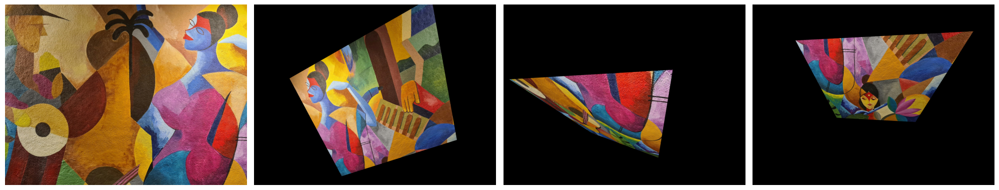


Displaying input images for I2: Reference Plane Image, Warped Image 1, Warped Image 2,Warped Image 3


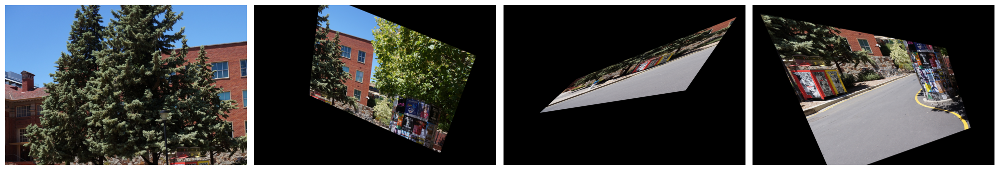


Displaying input images for I3: Reference Plane Image, Warped Image 1, Warped Image 2,Warped Image 3


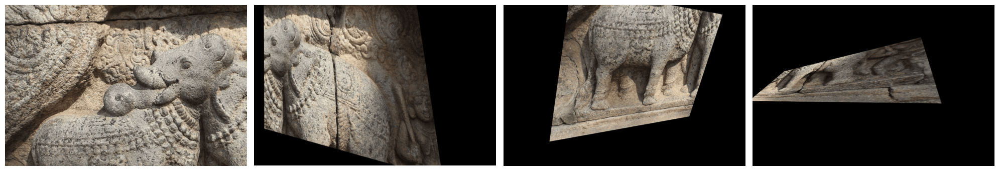


Displaying input images for I4: Reference Plane Image, Warped Image 1, Warped Image 2,Warped Image 3


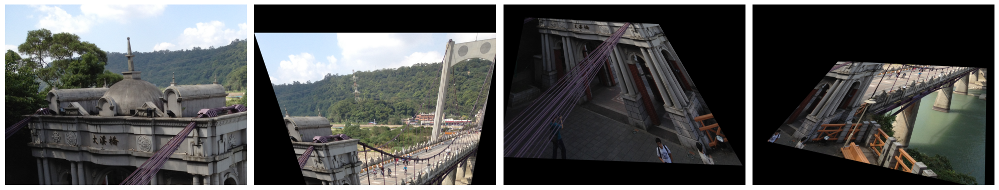


Displaying input images for I5: Reference Plane Image, Warped Image 1, Warped Image 2,Warped Image 3


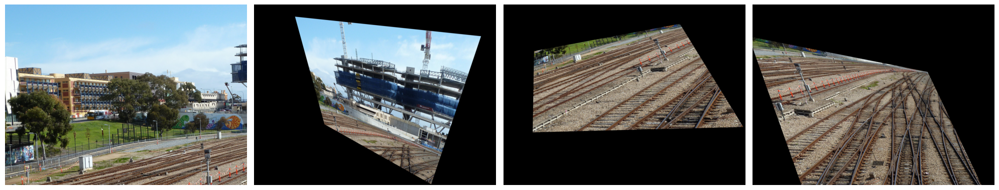

In [ ]:
## Importing recipes
%matplotlib inline

import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
from google.colab import drive
# Mounting google drive
drive.mount('/content/drive')

def display_images_in_row(images, cmap='gray'):
    fig, axs = plt.subplots(1, len(images), figsize=(5 * len(images), 5))
    if len(images) == 1:
        axs = [axs]
    for ax, img in zip(axs, images):
        ax.imshow(img, cmap=cmap)
        ax.axis('off')
    plt.tight_layout()
    plt.show()

base_dir = "/content/drive/MyDrive/ES666CV/images/C"  # Base directory containing I1, I2, ..., I5
all_images = []  # List to store restored images

for dataset in sorted(os.listdir(base_dir)):
    dataset_path = os.path.join(base_dir, dataset)
    if not os.path.isdir(dataset_path):
        continue

    # Reference image to get output size
    ref_img_path = os.path.join(dataset_path, "ref_plane_img.png")
    ref_img = cv2.imread(ref_img_path)
    ref_img = cv2.cvtColor(ref_img, cv2.COLOR_BGR2RGB)

    # List to store restored images for this dataset
    images = [ref_img]

    # Loop through warped regions 2,3,4
    for i in range(2, 5):
        warped_img_path = os.path.join(dataset_path, f"warped_region_{i}.png")

        # Load image and homography
        warped_img = cv2.imread(warped_img_path)
        warped_img = cv2.cvtColor(warped_img, cv2.COLOR_BGR2RGB)

        # Inverse warp
        images.append(warped_img)

    # Add restored images for this dataset to the main list
    all_images.append(images)


for idx,imgs in enumerate(all_images):
  print(f"\nDisplaying input images for I{idx+1}: Reference Plane Image, Warped Image 1, Warped Image 2,Warped Image 3")
  display_images_in_row(imgs, cmap=None)


# Task 1: Implement Inverse Warping from scratch (4 marks)
**Instructions:**

* Implement `warpPerspective_from_scratch(img, H, output_shape)` to
warp the input image img to a new plane. **The homography H maps coordinates in the source image to the target plane**, and output_shape defines the size (height, width) of the output.

* Implement `restore_images_in_reference_plane(img, H, output_shape)` to map a warped image img back to the reference plane using the inverse of H. **Here, H is the homography that originally mapped the reference plane to the warped image.**


In [ ]:
def warpPerspective_from_scratch(img, H, output_shape):
    """
    Inverse warp an image using a given homography matrix H.

    Parameters:
    img : np.array
        Input image to be warped.
    H : np.array
        Homography matrix mapping source -> target plane.
    output_shape : tuple
        (height, width) of the target image.

    Returns:
    restored : np.array
        The warped image of shape output_shape.
    """
    h, w = output_shape
    restored = np.zeros((h, w, img.shape[2]), dtype=img.dtype)

    ## TODO: Implement pixel-by-pixel inverse mapping using H
    ## Hint: For each pixel in source image, compute its destination in the output plane.

    return restored


def restore_images_in_reference_plane(img, H, output_shape):
    """
    Restore a warped image back to the reference plane using inverse homography.

    Parameters:
    img : np.array
        Warped image to be restored.
    H : np.array
        Homography matrix mapping reference -> warped plane.
    output_shape : tuple
        (height, width) of the reference plane.

    Returns:
    warped : np.array
        Restored image in the reference plane.
    """
    h_out, w_out = output_shape

    ## TODO: Compute H inverse: H_inv
    ## TODO: For each pixel in the output (reference) plane, compute the corresponding
    ## pixel location in the warped image using H_inv.
    H_new = None
    warped = warpPerspective_from_scratch(img, H_new, (h_out, w_out))

    return warped


Processing dataset: I1

Processing dataset: I2

Processing dataset: I3

Processing dataset: I4

Processing dataset: I5

Displaying restored images for I1:


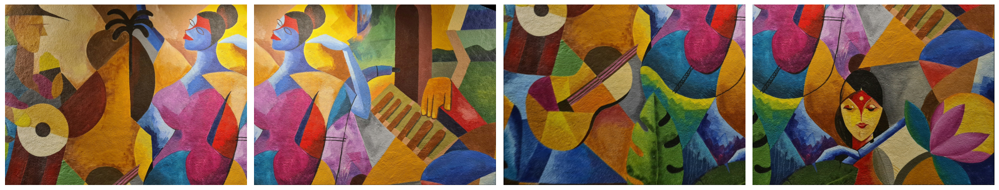


Displaying restored images for I2:


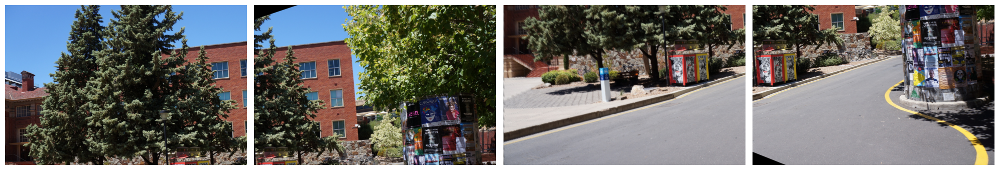


Displaying restored images for I3:


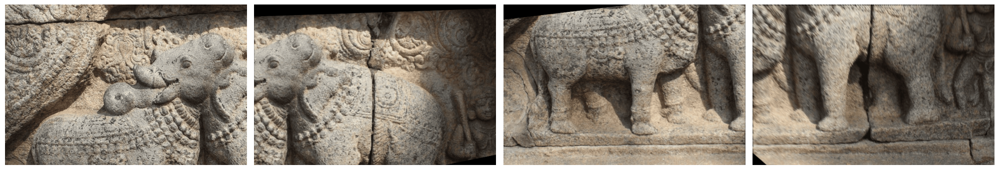


Displaying restored images for I4:


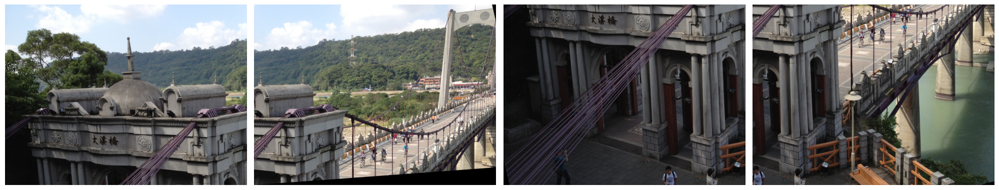


Displaying restored images for I5:


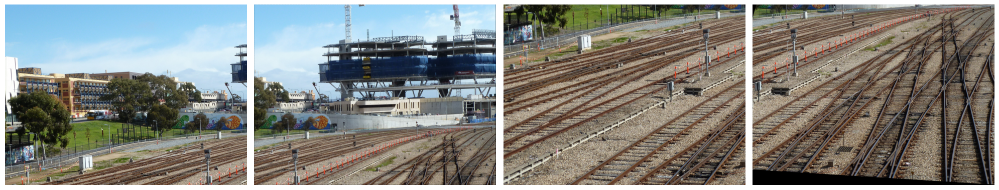

In [ ]:

restored_all = []  # List to store restored images

for dataset in sorted(os.listdir(base_dir)):
    dataset_path = os.path.join(base_dir, dataset)
    if not os.path.isdir(dataset_path):
        continue

    print(f"\nProcessing dataset: {dataset}")

    # Reference image to get output size
    ref_img_path = os.path.join(dataset_path, "ref_plane_img.png")
    ref_img = cv2.imread(ref_img_path)
    ref_img = cv2.cvtColor(ref_img, cv2.COLOR_BGR2RGB)
    h_out, w_out = ref_img.shape[:2]

    # Directory containing homography matrices
    homography_dir = os.path.join(dataset_path, "homographies")

    # List to store restored images for this dataset
    restored_dataset = [ref_img]

    # Loop through warped regions 2,3,4
    for i in range(2, 5):
        warped_img_path = os.path.join(dataset_path, f"warped_region_{i}.png")
        H_path = os.path.join(homography_dir, f"H_region_{i}.txt")

        # Load image and homography
        warped_img = cv2.imread(warped_img_path)
        warped_img = cv2.cvtColor(warped_img, cv2.COLOR_BGR2RGB)
        H = np.loadtxt(H_path)

        # Inverse warp
        restored_img = restore_images_in_reference_plane(warped_img, H, (h_out, w_out))
        restored_dataset.append(restored_img)

        # save restored image
        # output_dir = os.path.join(dataset_path, "restored")
        # os.makedirs(output_dir, exist_ok=True)
        # save_path = os.path.join(output_dir, f"restored_warped_region_{i}.png")
        # cv2.imwrite(save_path, restored_img)
        # print(f"Saved: {save_path}")

    # Add restored images for this dataset to the main list
    restored_all.append(restored_dataset)


for idx,imgs in enumerate(restored_all):
  print(f"\nDisplaying restored images for I{idx+1}:")
  display_images_in_row(imgs, cmap=None)


📖 **Theory Question:** Explain the difference between forward warping and inverse warping. Why is inverse warping generally preferred?

# Task 2: Keypoint Detection and Homography Estimation (4 marks)
**Instructions:**

* Detect keypoints and compute descriptors for each image using SIFT. Then, match keypoints between each restored region and the reference image. **You may use OpenCV functions for both detecting SIFT keypoints and matching descriptors.**

* Implement homography estimation using RANSAC from scratch. Do not use OpenCV’s findHomography for this step. Compute the homography matrix that aligns each region to the reference plane.

In [ ]:
def detect_keypoints_sift(img):
    """
    Detect keypoints and compute descriptors using SIFT.

    Parameters:
    img : np.array
        Input image in which keypoints are to be detected.

    Returns:
    keypoints : list
        Detected keypoints in the image.
    descriptors : np.array
        Feature descriptors corresponding to the keypoints.
    """
    ## TODO: Convert image to grayscale
    ## TODO: Detect SIFT keypoints
    ## TODO: Compute descriptors for the keypoints

    keypoints = None   # Replace with your implementation
    descriptors = None # Replace with your implementation
    return keypoints, descriptors

In [ ]:
def match_keypoints(des1, des2, ratio_thresh=0.75):
    """
    Match descriptors between two images using nearest neighbor and ratio test.

    Parameters:
    des1 : np.array
        Descriptors from the first image.
    des2 : np.array
        Descriptors from the second image.
    ratio_thresh : float
        Ratio threshold for filtering ambiguous matches.

    Returns:
    good_matches : list
        List of filtered good matches passing the ratio test.
    """
    ## TODO: Match descriptors using nearest neighbor (Using OpenCV)
    ## TODO: Apply ratio test to filter matches

    good_matches = None  # Replace with your implementation
    return good_matches

In [ ]:
def compute_homography_ransac(kp1, kp2, matches, iterations=1000, threshold=5):
    """
    Compute homography using matched keypoints and RANSAC.

    Parameters:
    kp1 : list
        Keypoints from the first image.
    kp2 : list
        Keypoints from the second image.
    matches : list
        Matches between keypoints of the two images.
    iterations : int
        Number of RANSAC iterations.
    threshold : float
        Distance threshold to classify inliers.

    Returns:
    H : np.array
        Estimated homography matrix mapping kp1 -> kp2.
    """
    ## TODO: Implement RANSAC to find the best homography
    ## TODO: Convert keypoints to coordinates
    ## TODO: Iteratively estimate H and count inliers

    H = None  # Replace with your implementation
    return H


Processing dataset 1
Dataset 1, Region 2 Homography:
 [[ 1.00002177e+00 -4.55114773e-04  1.61299213e+03]
 [ 5.27888828e-05  1.00029970e+00 -2.56625112e-02]
 [ 3.76586909e-10 -2.78890406e-07  1.00000000e+00]]


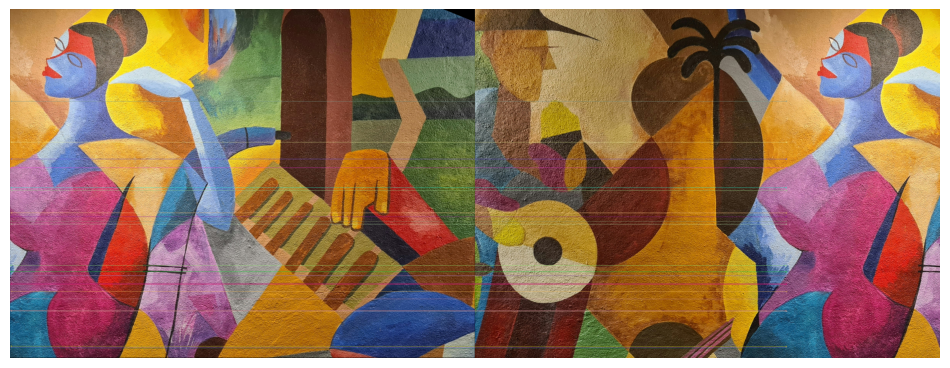

Dataset 1, Region 3 Homography:
 [[ 1.00183801e+00 -1.78248290e-03 -3.51805183e-02]
 [ 1.00630206e-03  9.99034126e-01  1.21000414e+03]
 [ 1.08545555e-06 -1.06390550e-06  1.00000000e+00]]


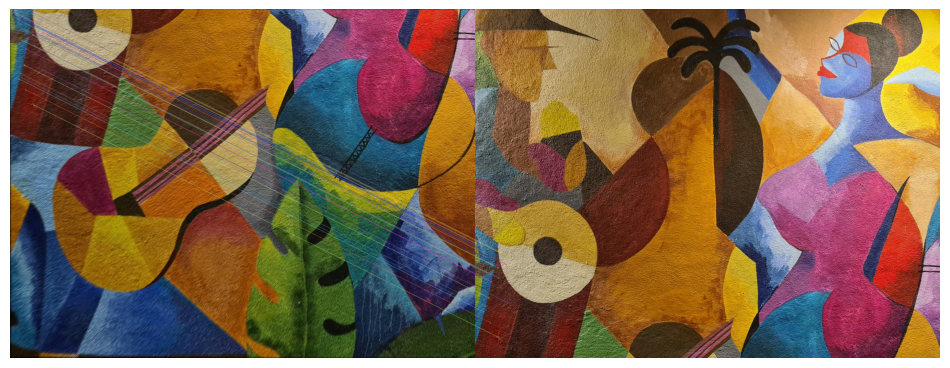

Dataset 1, Region 4 Homography:
 [[ 9.99329842e-01 -2.39381299e-04  1.61300001e+03]
 [-4.42996048e-04  9.99855639e-01  1.20998903e+03]
 [-5.13513698e-07 -2.28812902e-07  1.00000000e+00]]


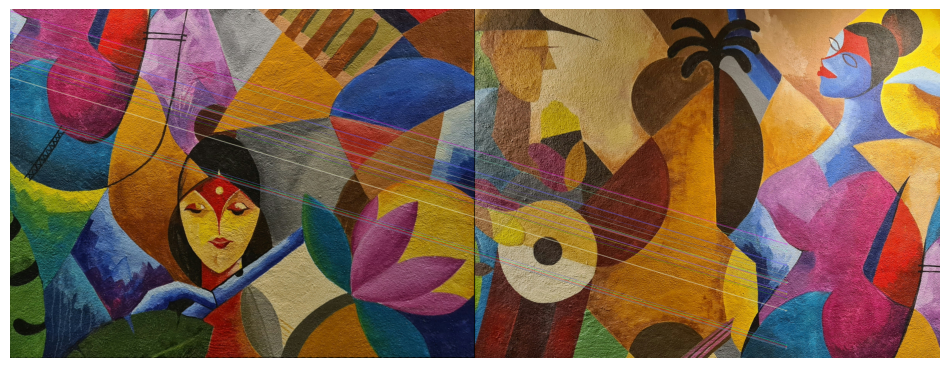


Processing dataset 2
Dataset 2, Region 2 Homography:
 [[ 9.99727592e-01 -1.32739914e-05  8.00010458e+02]
 [-1.54089163e-04  9.99963096e-01  2.24641696e-02]
 [-4.13051816e-07  3.30451828e-08  1.00000000e+00]]


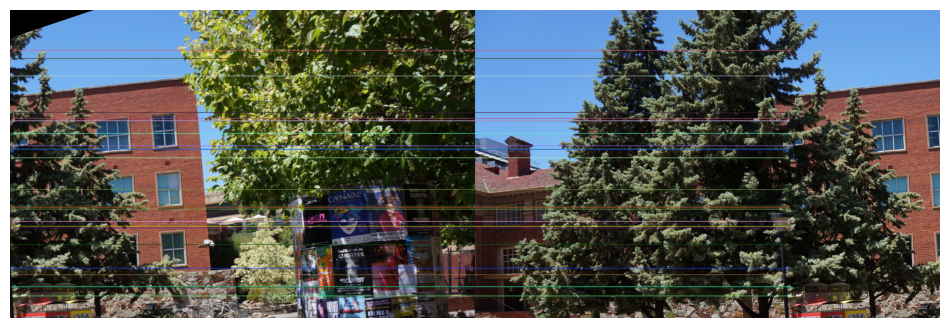

Dataset 2, Region 3 Homography:
 [[ 9.98850315e-01 -4.13475053e-03  1.13058833e+00]
 [ 2.15027921e-04  9.95635550e-01  5.32211462e+02]
 [-3.80216040e-07 -3.15123072e-06  1.00000000e+00]]


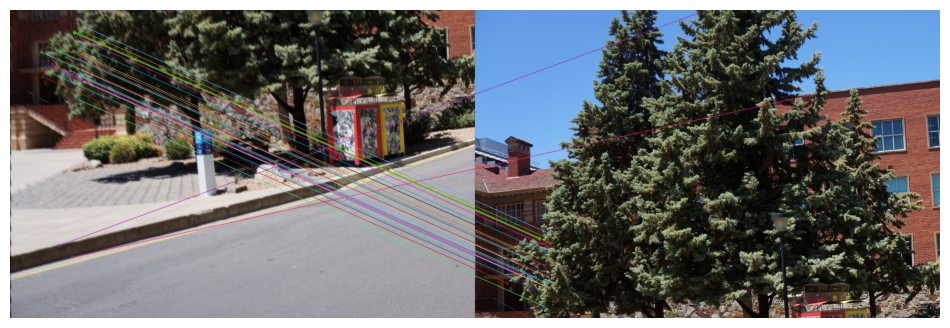

Dataset 2, Region 4 Homography:
 [[1.00061097e+00 8.79562192e-04 7.99972976e+02]
 [3.60947192e-04 1.00077978e+00 5.31965753e+02]
 [4.87296977e-07 9.46359153e-07 1.00000000e+00]]


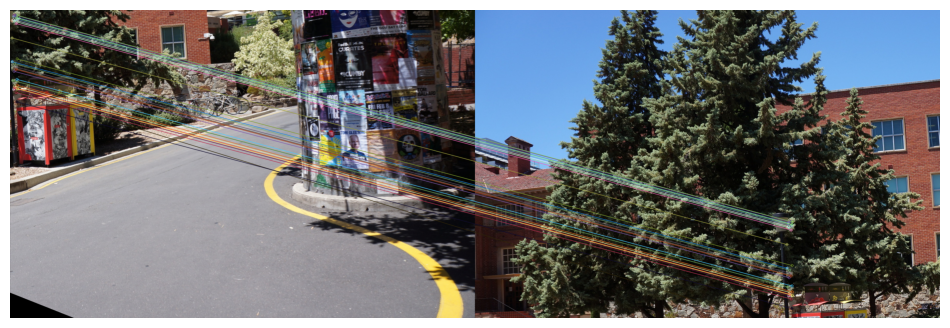


Processing dataset 3
Dataset 3, Region 2 Homography:
 [[ 9.99978490e-01 -3.99388429e-04  4.10006241e+02]
 [ 1.52682136e-04  9.99693878e-01  2.08318139e-02]
 [ 4.79748813e-07 -8.15471392e-07  1.00000000e+00]]


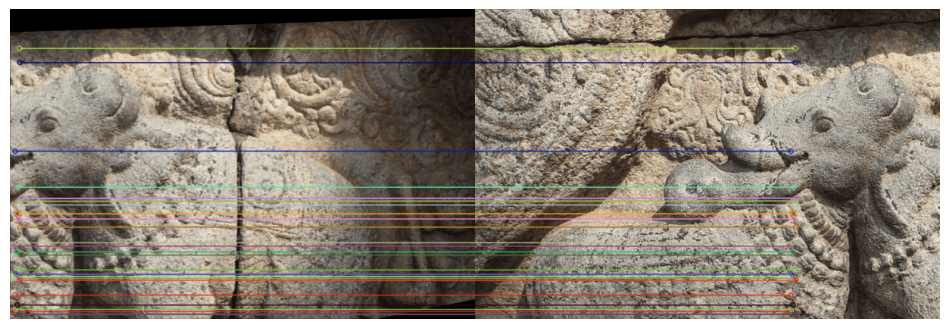

Dataset 3, Region 3 Homography:
 [[ 9.99840596e-01 -2.61032436e-04  4.18209713e-02]
 [-3.72683647e-04  9.99607848e-01  2.73054910e+02]
 [-7.82620903e-07 -6.83541002e-07  1.00000000e+00]]


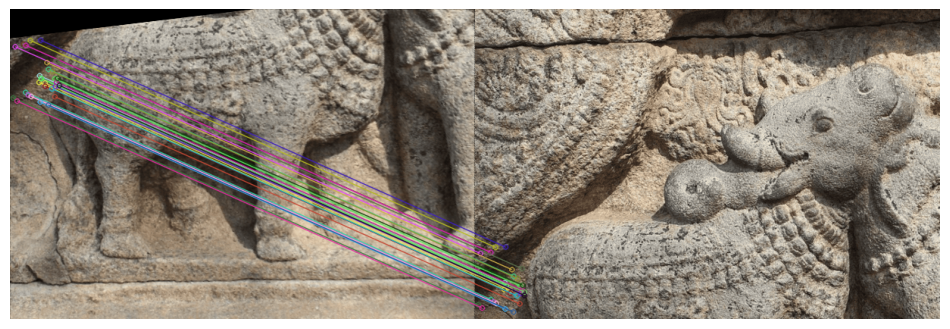

Dataset 3, Region 4 Homography:
 [[1.21546906e+00 2.19036375e-01 4.03664866e+02]
 [9.67511738e-02 1.21583901e+00 2.68982675e+02]
 [2.99228170e-04 4.24248678e-04 1.00000000e+00]]


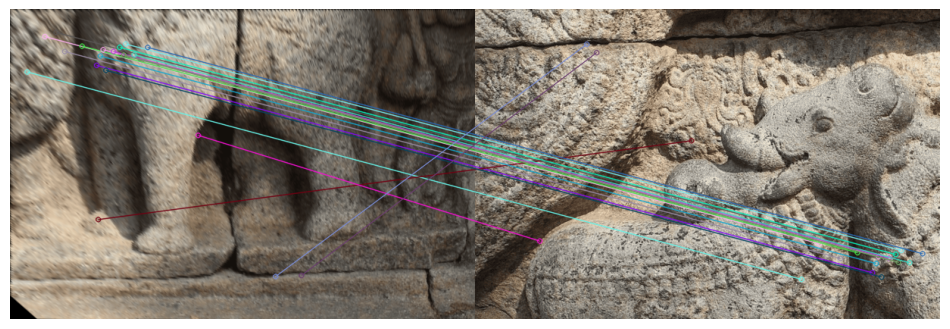


Processing dataset 4
Dataset 4, Region 2 Homography:
 [[ 9.99948546e-01 -4.64823397e-04  1.30597991e+03]
 [-1.19186744e-05  1.00006594e+00  5.29275631e-03]
 [-5.14642677e-08 -3.38378617e-07  1.00000000e+00]]


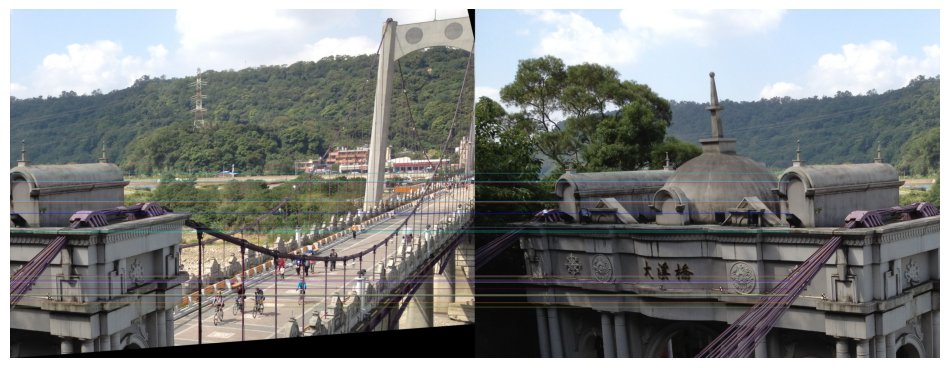

Dataset 4, Region 3 Homography:
 [[ 1.00000165e+00 -1.15287993e-03  1.61482989e-01]
 [-2.86843767e-04  9.98716611e-01  9.80006997e+02]
 [-4.28857998e-07 -8.98981447e-07  1.00000000e+00]]


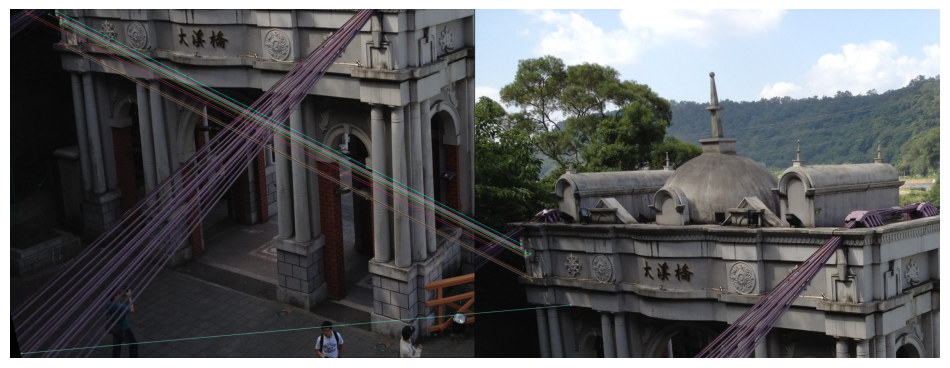

Dataset 4, Region 4 Homography:
 [[1.00172179e+00 6.46820324e-03 1.30568974e+03]
 [4.67461706e-04 1.00553807e+00 9.79895245e+02]
 [5.02390981e-07 3.58208400e-06 1.00000000e+00]]


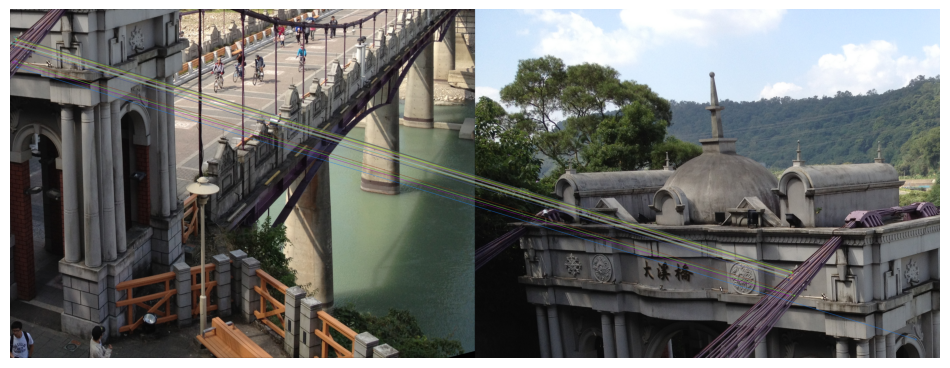


Processing dataset 5
Dataset 5, Region 2 Homography:
 [[ 9.99334608e-01  6.49774041e-04  7.99991301e+02]
 [-2.82054243e-04  1.00070058e+00 -1.24488171e-01]
 [-9.07044367e-07  3.73326675e-07  1.00000000e+00]]


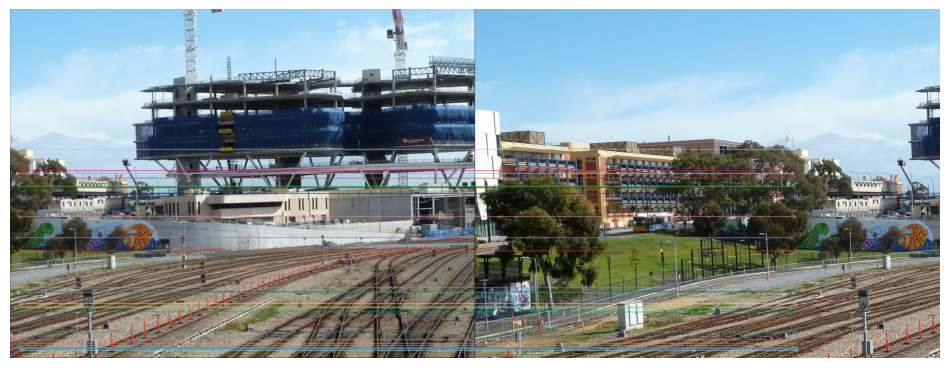

Dataset 5, Region 3 Homography:
 [[ 9.99782925e-01 -2.00494350e-03  2.66745218e-01]
 [ 2.19915616e-05  9.98045580e-01  6.00046149e+02]
 [ 5.15137646e-07 -2.39320516e-06  1.00000000e+00]]


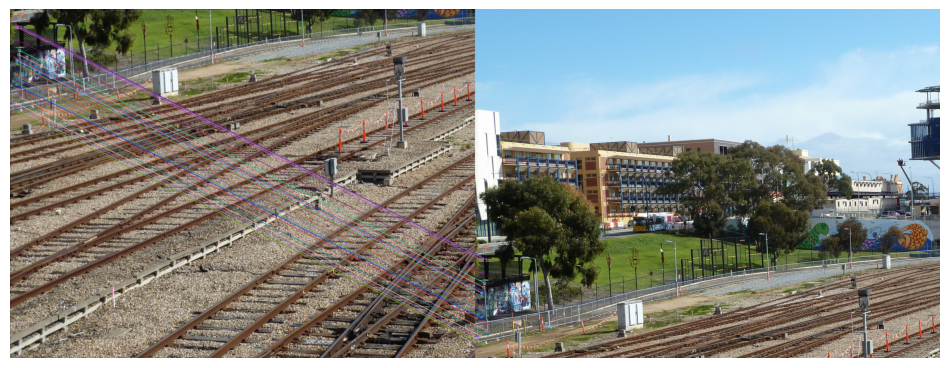

Dataset 5, Region 4 Homography:
 [[ 9.99724389e-01  6.39371444e-04  8.00006374e+02]
 [-1.88489859e-04  1.00062574e+00  5.99995474e+02]
 [-3.08034326e-07  6.50990949e-07  1.00000000e+00]]


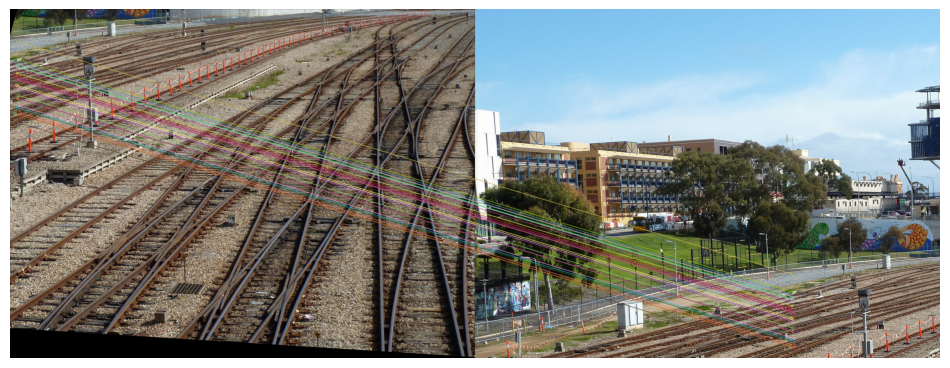

In [ ]:
homographies_all = []  # nested list: [dataset][region_index] -> H

for dataset_idx, dataset_images in enumerate(restored_all):
    print(f"\nProcessing dataset {dataset_idx+1}")
    homographies_dataset = []

    # Use the reference image as base (assume region_1 is at index 0)
    ref_img = dataset_images[0]
    kp_ref, des_ref = detect_keypoints_sift(ref_img)

    # Compute homography for each of the other restored regions
    for region_idx in range(1, len(dataset_images)):
        img = dataset_images[region_idx]
        kp, des = detect_keypoints_sift(img)

        matches = match_keypoints(des, des_ref)


        H = compute_homography_ransac(kp, kp_ref, matches)
        homographies_dataset.append(H)

        print(f"Dataset {dataset_idx+1}, Region {region_idx+1} Homography:\n", H)

        # visualize matches
        img_matches = cv2.drawMatches(img, kp, ref_img, kp_ref, matches[:30], None, flags=2)
        plt.figure(figsize=(12,6))
        plt.imshow(img_matches)
        plt.axis('off')
        plt.show()

    homographies_all.append(homographies_dataset)

📖 **Theory Question:** What could happen if you compute a homography using all matched points without handling outliers? Give an example.

# Task 3: Stitch the Images to Form the Original Image (2 Marks)

* Complete the function `stitch_with_known_homographies(base_img, other_imgs, homographies)` to stitch all regions into the original reference plane.
* **Use your implementation of `warpPerspective_from_scratch()` to warp each region into the base image plane.**
* **Ensure the base image (ref_plane_img.png) remains unaltered and all warped regions are aligned correctly using the homographies you have calculated in the preevious step.**
* Return the final stitched image with the same dimensions as the base image.

In [ ]:
def stitch_with_known_homographies(base_img, other_imgs, homographies):
    """
    Stitch multiple image regions into the plane of a base image using known homographies.

    Parameters:
    base_img : np.array
        Reference image (Region 1) that serves as the base plane.
    other_imgs : list of np.array
        Restored regions (e.g., Regions 2, 3, 4) to be stitched.
    homographies : list of np.array
        Homography matrices mapping each region to the base image plane.

    Returns:
    stitched_image : np.array
        The final stitched image containing all regions aligned to the base plane.
    """
    ## TODO: Determine the canvas size for stitching
    ## TODO: Place the base image in the canvas
    ## TODO: Translate homographies to canvas coordinates if needed
    ## TODO: Warp each region using your warpPerspective implementation
    ## TODO: Merge warped regions onto the canvas (e.g., simple overwrite or blending)

    stitched_image = None  # Replace with your implementation

    return stitched_image



[INFO] Processing dataset 1
[INFO] Saved stitched result: stitched_results/stitched_dataset_1.png


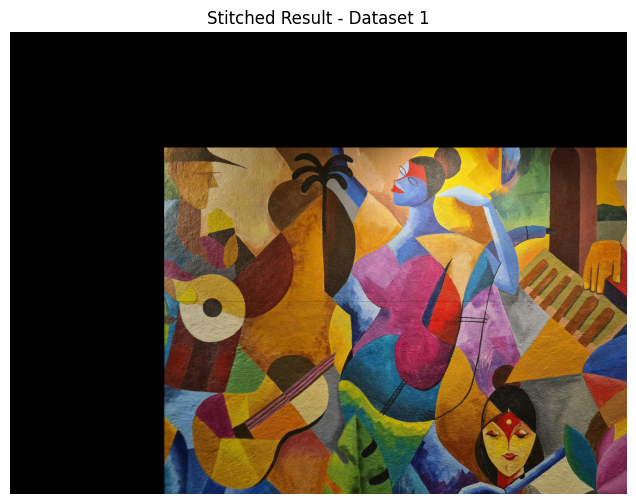


[INFO] Processing dataset 2
[INFO] Saved stitched result: stitched_results/stitched_dataset_2.png


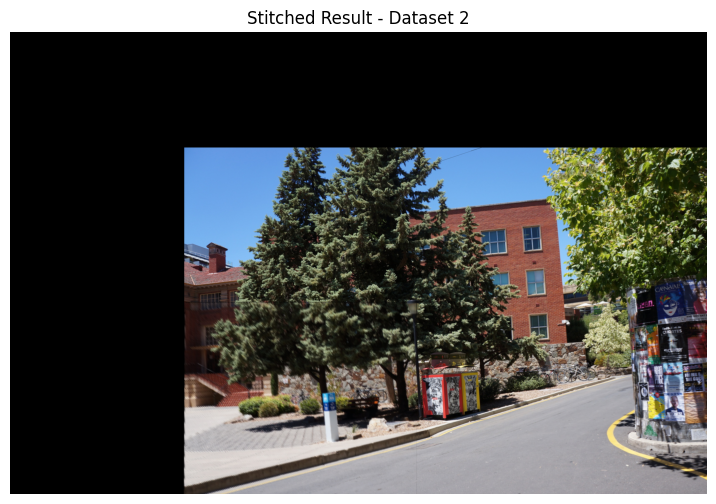


[INFO] Processing dataset 3
[INFO] Saved stitched result: stitched_results/stitched_dataset_3.png


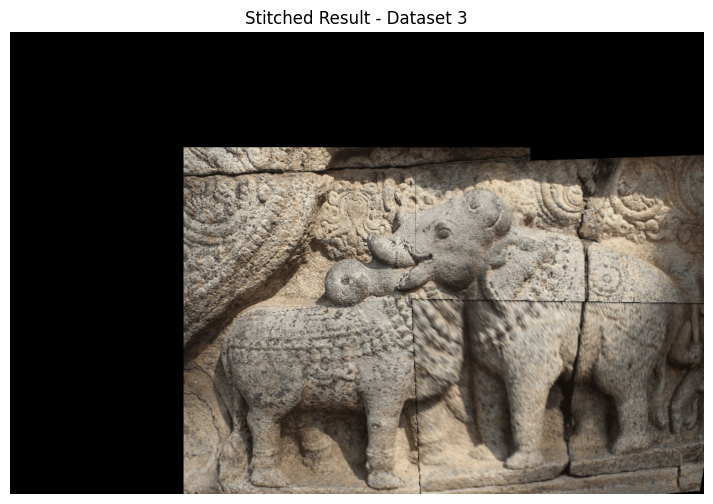


[INFO] Processing dataset 4
[INFO] Saved stitched result: stitched_results/stitched_dataset_4.png


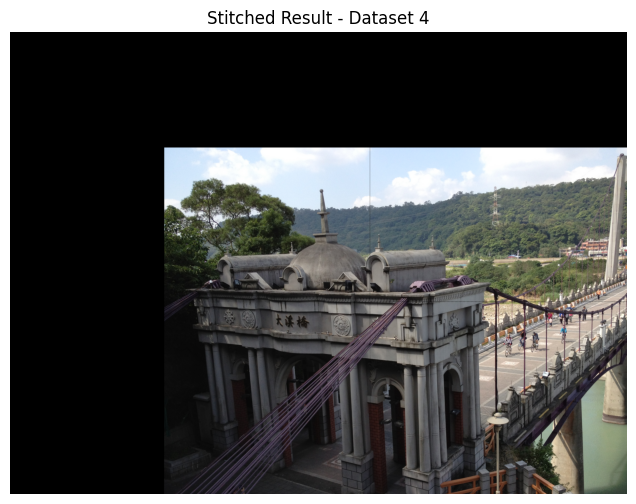


[INFO] Processing dataset 5
[INFO] Saved stitched result: stitched_results/stitched_dataset_5.png


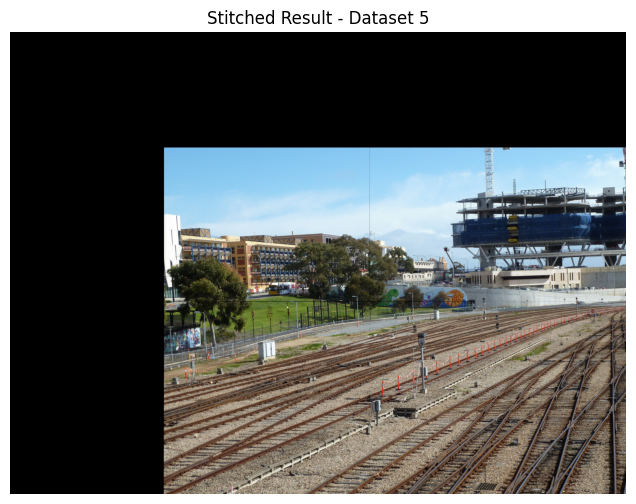

In [ ]:
# ----------------------------
# Run stitching on all datasets
# ----------------------------
stitched_all = []
output_dir = "stitched_results"
os.makedirs(output_dir, exist_ok=True)

for dataset_idx, dataset_images in enumerate(restored_all):
    print(f"\n[INFO] Processing dataset {dataset_idx+1}")

    # First image is reference (Region 1)
    ref_img = dataset_images[0]

    # Remaining images are other regions
    other_imgs = dataset_images[1:]

    # Homographies for this dataset
    homographies = homographies_all[dataset_idx]

    # Stitch
    stitched = stitch_with_known_homographies(ref_img, other_imgs, homographies)
    stitched_all.append(stitched)

    # Save
    save_path = os.path.join(output_dir, f"stitched_dataset_{dataset_idx+1}.png")
    cv2.imwrite(save_path, stitched)
    print(f"[INFO] Saved stitched result: {save_path}")

    # Show
    stitched_rgb = stitched
    plt.figure(figsize=(12,6))
    plt.imshow(stitched_rgb)
    plt.title(f"Stitched Result - Dataset {dataset_idx+1}")
    plt.axis("off")
    plt.show()

📖 **Theory Question:** Why is it important that the base image remains unaltered during stitching?